<a href="https://colab.research.google.com/github/caelliastate/Image-Processing/blob/main/DSPG.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import skimage
from skimage.restoration import inpaint
import matplotlib.pyplot as plt
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image
from scipy import ndimage

In [ ]:
map = skimage.io.imread('/image_0038.jpg')

In [ ]:
def show_image(image, title):
    plt.imshow(image)
    plt.title(title)
    plt.autoscale(axis='x')
    plt.show()

In [ ]:
%matplotlib inline


In [ ]:
img = np.asarray(Image.open('/image_0038.jpg'))
print(repr(img))

array([[[ 26,  26,  28],
        [ 30,  30,  32],
        [ 31,  31,  33],
        ...,
        [225, 223, 208],
        [212, 210, 197],
        [210, 208, 195]],

       [[ 27,  27,  29],
        [ 29,  29,  31],
        [ 28,  28,  30],
        ...,
        [229, 227, 212],
        [224, 222, 209],
        [222, 220, 207]],

       [[ 18,  18,  20],
        [ 20,  20,  22],
        [ 19,  19,  21],
        ...,
        [233, 231, 216],
        [234, 232, 217],
        [232, 230, 215]],

       ...,

       [[239, 244, 247],
        [239, 244, 247],
        [239, 244, 247],
        ...,
        [ 26,  23,  30],
        [ 24,  27,  32],
        [ 23,  31,  34]],

       [[240, 245, 248],
        [239, 244, 247],
        [239, 244, 247],
        ...,
        [ 23,  23,  31],
        [ 12,  18,  16],
        [ 10,  21,  13]],

       [[240, 245, 248],
        [239, 244, 247],
        [239, 244, 247],
        ...,
        [ 23,  23,  31],
        [ 19,  28,  23],
        [ 19,  31,  19]]

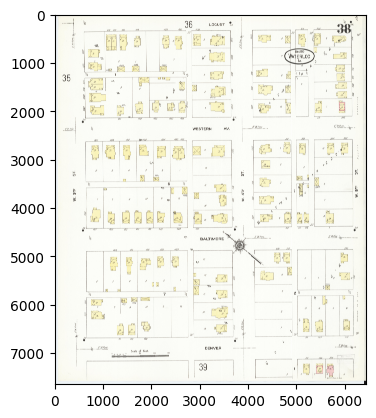

In [ ]:
plt.imshow(img)

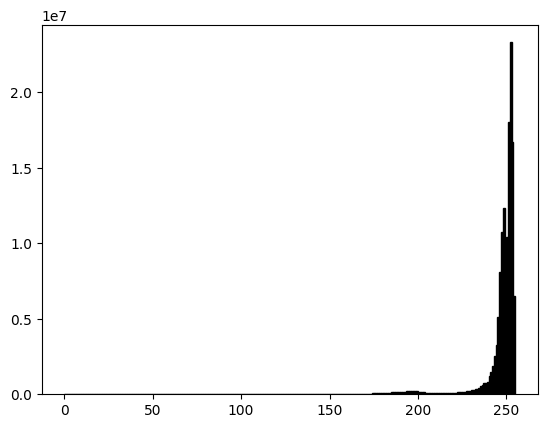

In [ ]:
plt.hist(img.ravel(), bins=range(256), fc='k', ec='k')
plt.show()

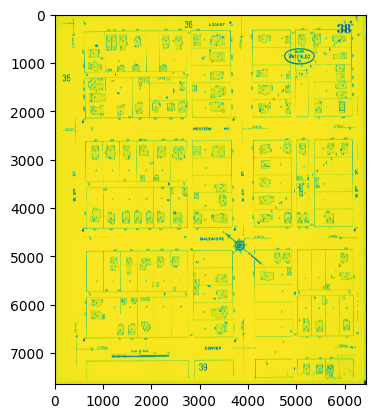

In [ ]:
gray_map = skimage.color.rgb2gray(img)
plt.imshow(gray_map)

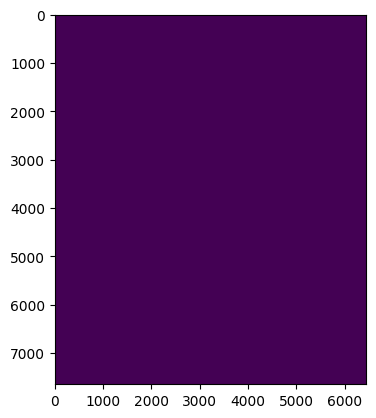

In [ ]:
gray_map = skimage.morphology.binary_erosion(gray_map)
plt.imshow(gray_map)

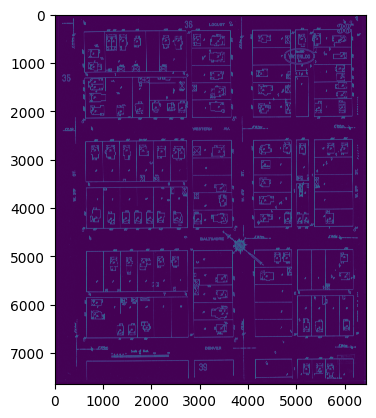

In [ ]:
edges = skimage.filters.sobel(gray_map)
plt.imshow(edges)

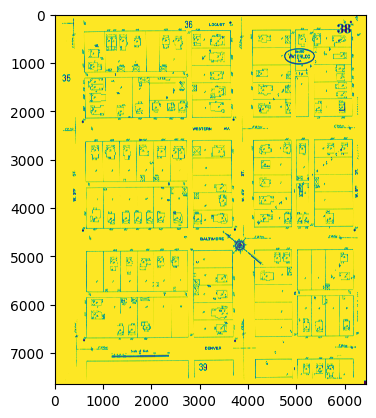

In [ ]:
thresh2 = skimage.filters.threshold_otsu(gray_map)
thresh_image = gray_map > thresh2
plt.imshow(thresh_image)

In [ ]:
labeled, nr_objects = ndimage.label( gray_map > thresh2)

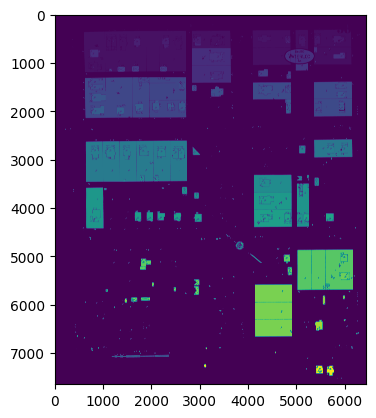

In [ ]:
plt.imshow(labeled)
plt.show()

In [ ]:
contours2 = skimage.measure.find_contours(labeled, level = 10)
print(len(contours2))

2281


In [ ]:
first_contour = contours2[100].astype(int)

In [ ]:
start_row = min(first_contour[:, 0])
end_row = max(first_contour[:, 0])
start_col = min(first_contour[:, 1])
end_col = max(first_contour[:, 1])

In [ ]:
print(start_row, end_row, start_col, end_col)

434 592 4196 4463


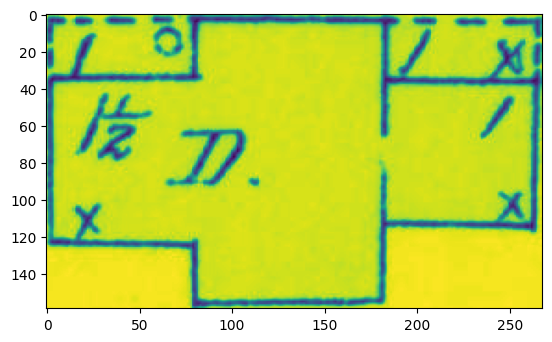

In [ ]:
plt.imshow(gray_map[start_row:end_row+1, start_col:end_col+1])

In [ ]:
area_building = (end_row - start_row) * (end_col - start_col)
print(area_building)

42186


In [ ]:
map2 = cv2.cvtColor(map, cv2.COLOR_BGR2GRAY)

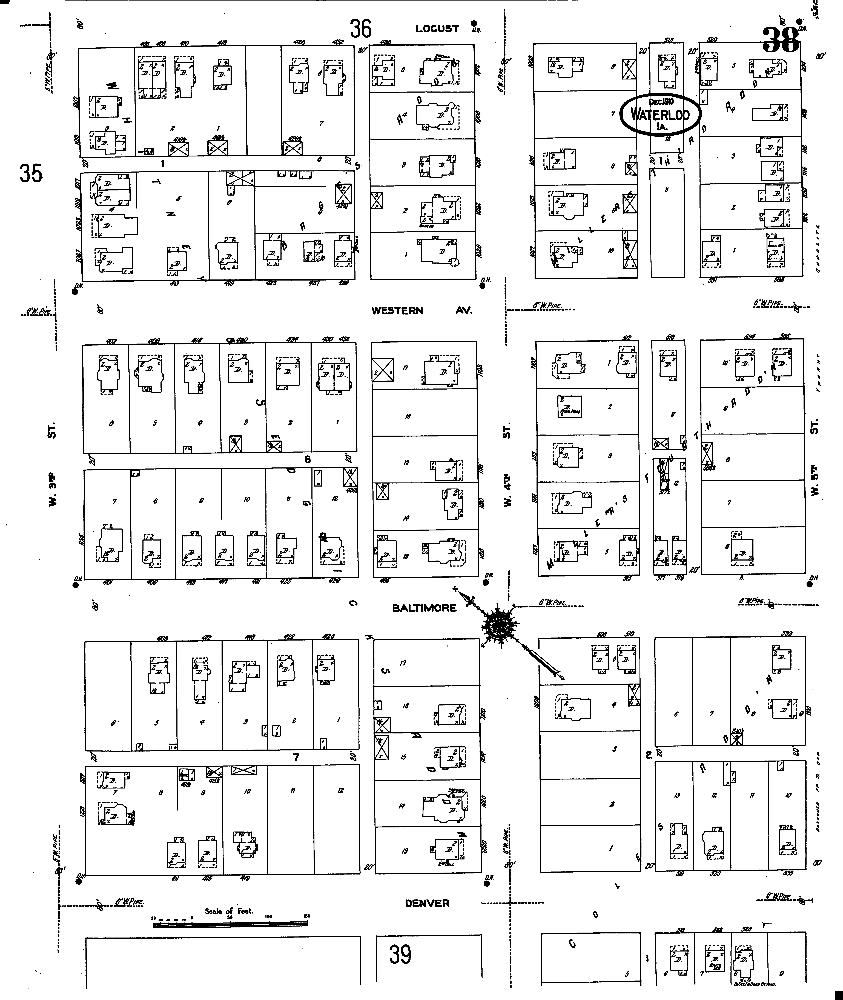

In [ ]:
# apply binary thresholding
ret, thresh = cv2.threshold(map2, 150, 255, cv2.THRESH_BINARY)
# visualize the binary image
cv2_imshow(thresh)
cv2.waitKey(0)
cv2.imwrite('image_thres1.jpg', thresh)
cv2.destroyAllWindows()

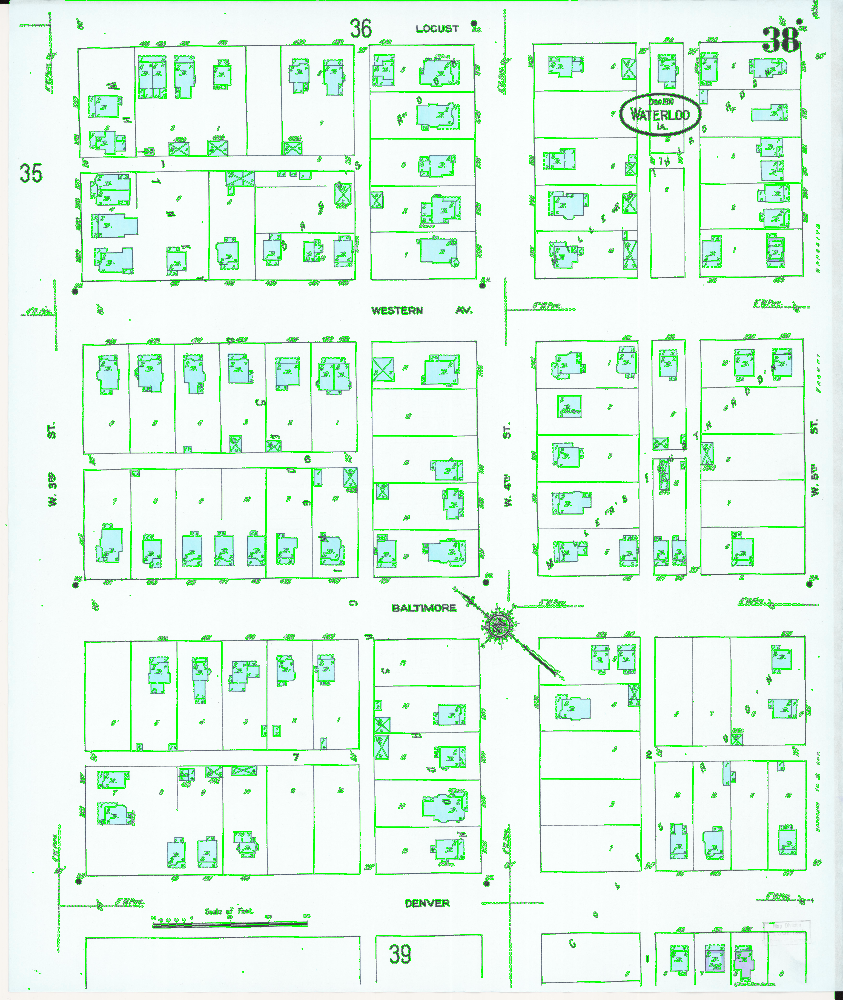

In [ ]:
contours, hierarchy = cv2.findContours(image=thresh, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)

# draw contours on the original image
image_copy = map.copy()
cv2.drawContours(image=image_copy, contours=contours, contourIdx=-1, color=(0, 256, 0), thickness=2, lineType=cv2.FILLED)

# see the results
cv2_imshow(image_copy)
cv2.waitKey(0)
cv2.imwrite('contours_none_image1.jpg', image_copy)
cv2.destroyAllWindows()

In [ ]:
first_contour2 = contours[1000].astype(int)

In [ ]:
start_row = min(first_contour2[:, 0, 0])
end_row = max(first_contour2[:, 0, 0])
start_col = min(first_contour2[:, 0, 1])
end_col = max(first_contour2[:, 0, 1])

In [ ]:
print(start_row, end_row, start_col, end_col)

4131 4895 5237 5590


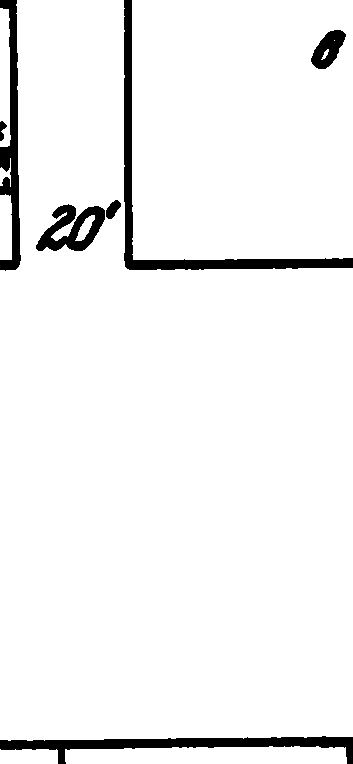

In [ ]:
cv2_imshow(thresh[start_row:end_row, start_col:end_col])
cv2.waitKey(0)
cv2.imwrite('image_thres2.jpg', thresh[start_row:end_row-1, start_col:end_col])
cv2.destroyAllWindows()

In [ ]:
second_contour = contours[900].astype(int)

In [ ]:
start_row = min(second_contour[:, 0, 0])
end_row = max(second_contour[:, 0, 0])
start_col = min(second_contour[:, 0, 1])
end_col = max(second_contour[:, 0, 1])

In [ ]:
print(start_row, end_row, start_col, end_col)

1899 1931 6538 6560


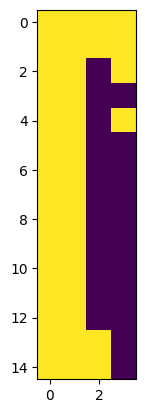

In [ ]:
plt.imshow(thresh[start_row:end_row, start_col:end_col])

In [ ]:
canny_edges = cv2.Canny(map2, threshold1=100, threshold2=200)

In [ ]:
contours3, hierarchy = cv2.findContours(canny_edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

In [ ]:
image_with_contours = cv2.drawContours(map2, contours3, -1, (0, 255, 0), 3)

In [ ]:
cv2.imwrite('contours_image.jpg', image_with_contours)

True

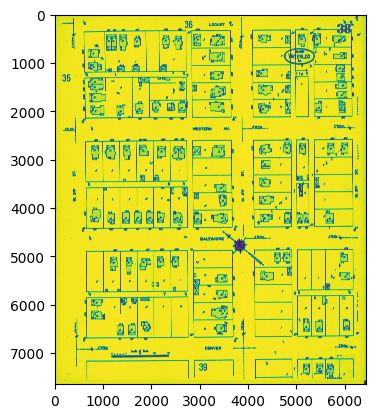

In [ ]:
plt.imshow(image_with_contours)

In [ ]:
first = contours3[1]
print(first)

[[[ 221 7563]]

 [[ 223 7565]]

 [[ 223 7566]]

 [[ 222 7567]]

 [[ 220 7565]]

 [[ 219 7565]]

 [[ 221 7567]]

 [[ 223 7567]]

 [[ 224 7566]]

 [[ 223 7565]]

 [[ 223 7564]]

 [[ 222 7564]]]


In [ ]:
start_row2 = min(first[:, 0 , 0])
end_row2 = max(first[:, 0, 0])
start_col2 = min(first[:, 0, 1])
end_col2 = max(first[:, 0 , 1])

In [ ]:
print(start_row2, end_row2, start_col2, end_col2)

219 224 7563 7567


<ipython-input-93-f1553ee5d9c4>:1: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  plt.imshow(map2[start_row2:end_row2, start_col2:end_col2])


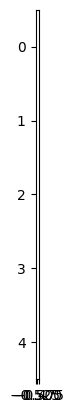

In [ ]:
plt.imshow(map2[start_row2:end_row2, start_col2:end_col2])

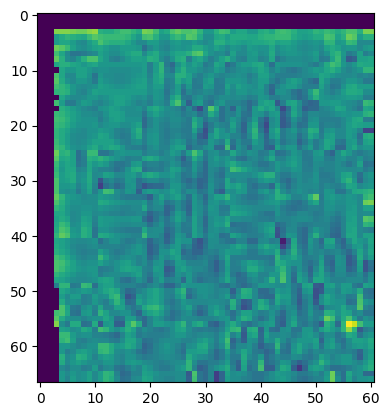